In [1]:
using Revise
using SWCForecast
using CSV, DataFrames, Gadfly, Dates, Compose
using Statistics
using Cairo, Fontconfig
using Colors
using HypertextLiteral

┌ Info: Precompiling SWCForecast [9cc579f6-159f-437b-aca9-4422b081c04c]
└ @ Base loading.jl:1342


In [2]:
cd(projectdir())

In [3]:
notebooksdir("202202_dataview2018", "data2018_01_dfprocessing.jl") |> include # get processed dataframe `df`
notebooksdir("202202_dataview2018", "plotfunctions.jl") |> includet

In [4]:
# make sure n >= the maximum number of feature elements belongs to each group (plot)
n = 15
colors = distinguishable_colors(15, [RGB(1,1,1), RGB(0,0,0)], dropseed=true)

In [5]:
defaultcolor = Scale.color_discrete_hue()
defaultcolor.f(3) # an example showing how to use

In [6]:
heatmapcolors = parse.(Colorant, ["lawngreen", "firebrick2", "black"])

## Data overview
### Water level

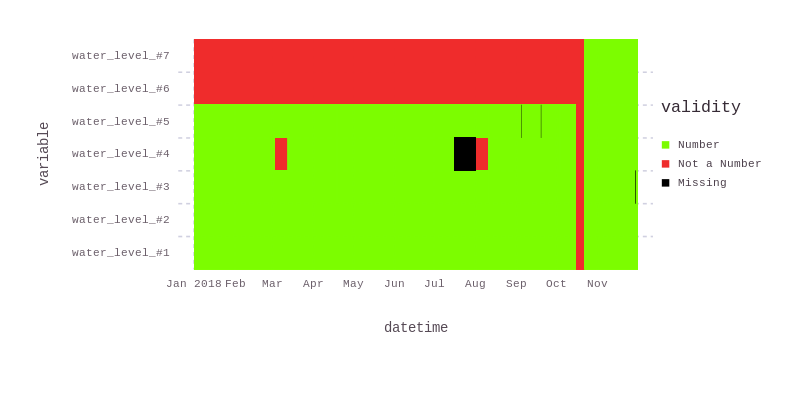

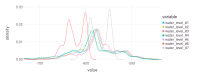

<table>
    <caption> Summary for <b>Water Level</b>: </caption>
    <tr><th> variable
        <th> mean
        <th> standard deviation
    </tr>

    <tr>
    <td> water_level_#1
    <td> -581.43
    <td> 49.85
</tr>
<tr>
    <td> water_level_#2
    <td> -577.14
    <td> 51.62
</tr>
<tr>
    <td> water_level_#3
    <td> -575.65
    <td> 49.9
</tr>
<tr>
    <td> water_level_#4
    <td> -590.12
    <td> 54.28
</tr>
<tr>
    <td> water_level_#5
    <td> -574.88
    <td> 49.43
</tr>
<tr>
    <td> water_level_#6
    <td> -624.12
    <td> 22.65
</tr>
<tr>
    <td> water_level_#7
    <td> -572.07
    <td> 22.45
</tr>



</table>

In [7]:
targetstr = r"water_level"
summarytable = plot_data2018(targetstr, df; 
    density_plot=[Coord.cartesian(xmin=-730, xmax=-440)], 
    rectbin_plot=[Scale.color_discrete_manual(heatmapcolors...)]);
table_data2018(summarytable) |> display

**Brief summary**
- Water level in well **#6 and #7** is not available for most of the time.
- Is the spikes (outliers) reasonable?

### Water temperature

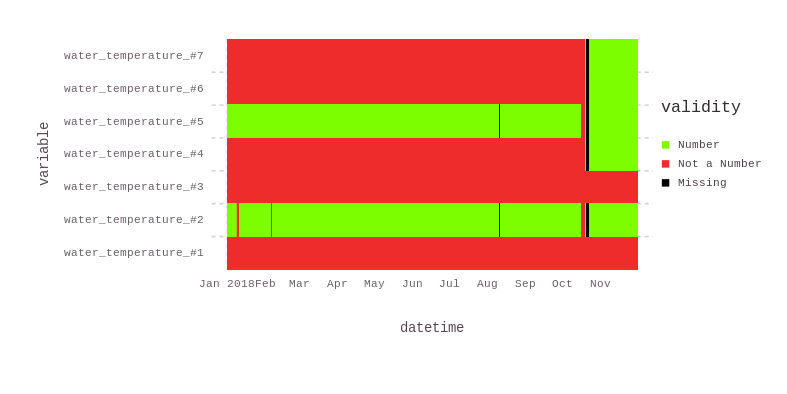

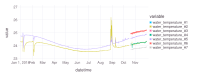

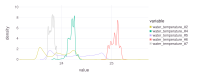

<table>
    <caption> Summary for <b>Water Temperature</b>: </caption>
    <tr><th> variable
        <th> mean
        <th> standard deviation
    </tr>

    <tr>
    <td> water_temperature_#2
    <td> 23.92
    <td> 0.3
</tr>
<tr>
    <td> water_temperature_#4
    <td> 24.2
    <td> 0.07
</tr>
<tr>
    <td> water_temperature_#5
    <td> 24.26
    <td> 0.38
</tr>
<tr>
    <td> water_temperature_#6
    <td> 25.07
    <td> 0.08
</tr>
<tr>
    <td> water_temperature_#7
    <td> 23.81
    <td> 0.05
</tr>



</table>

In [8]:
targetstr = r"water_temperature"
c = names(df, targetstr) |> length |> n -> defaultcolor.f(n) 

summarytable = plot_data2018(targetstr, df; 
    timeseries_plot=[Scale.color_discrete_manual(c...)],
    density_plot=[Coord.cartesian(xmin=23.2, xmax=25.7), Scale.color_discrete_manual(c[[2,4,5,6,7]]...)], 
    rectbin_plot=[Scale.color_discrete_manual(heatmapcolors..., order=[2,1,3])]);
table_data2018(summarytable) |> display

**Brief summary**
- Water temperature in well **#1, #3, #4, #6 and #7** is not available for most of the time; in which, data of **#1 and #3** are totally unavailable.
- What are the possible causes for the fluctuations ($\pm 2 ^\circ C$) in the water temperature? 

### Soil temperature

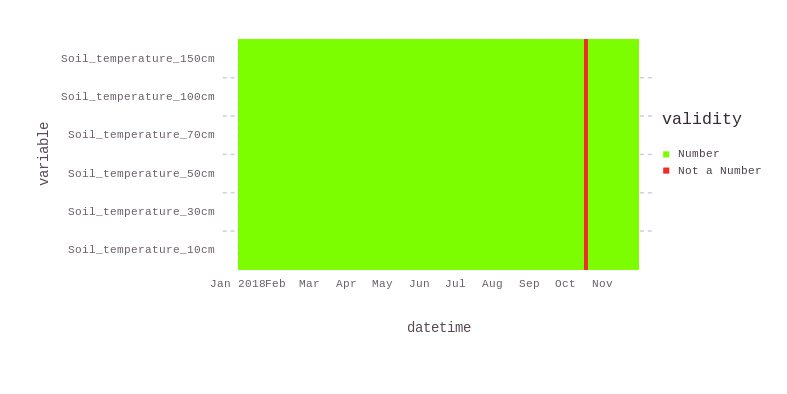

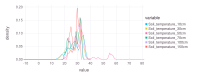

<table>
    <caption> Summary for <b>Soil Temperature</b>: </caption>
    <tr><th> variable
        <th> mean
        <th> standard deviation
    </tr>

    <tr>
    <td> Soil_temperature_10cm
    <td> 28.21
    <td> 8.68
</tr>
<tr>
    <td> Soil_temperature_30cm
    <td> 27.32
    <td> 16.35
</tr>
<tr>
    <td> Soil_temperature_50cm
    <td> 33.2
    <td> 9.32
</tr>
<tr>
    <td> Soil_temperature_70cm
    <td> 28.13
    <td> 4.04
</tr>
<tr>
    <td> Soil_temperature_100cm
    <td> 27.89
    <td> 8.67
</tr>
<tr>
    <td> Soil_temperature_150cm
    <td> 28.1
    <td> 3.06
</tr>



</table>

In [9]:
targetstr = r"Soil_temperature"
summarytable = plot_data2018(targetstr, df; 
    timeseries_plot=[Coord.cartesian(ymin=-10, ymax=80)],
    density_plot=[Coord.cartesian(xmin=-10, xmax=80)],
    rectbin_plot=[Scale.color_discrete_manual(heatmapcolors...)])
table_data2018(summarytable) |> display

**Brief summary**
- Soil temperature in at every depths are available for most of the time.
- What are the possible causes for the fluctuations ($+50 ^\circ C$) in the soil temperature as 50cm depth in the interval around Feb. to Apr., 2018? 

### Soil water content

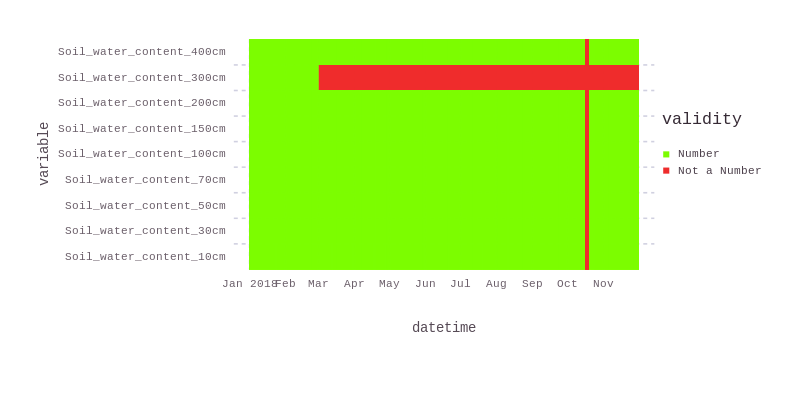

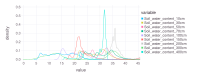

<table>
    <caption> Summary for <b>Soil Water Content</b>: </caption>
    <tr><th> variable
        <th> mean
        <th> standard deviation
    </tr>

    <tr>
    <td> Soil_water_content_10cm
    <td> 14.62
    <td> 5.2
</tr>
<tr>
    <td> Soil_water_content_30cm
    <td> 28.38
    <td> 4.4
</tr>
<tr>
    <td> Soil_water_content_50cm
    <td> 29.52
    <td> 4.18
</tr>
<tr>
    <td> Soil_water_content_70cm
    <td> 31.12
    <td> 5.18
</tr>
<tr>
    <td> Soil_water_content_100cm
    <td> 20.87
    <td> 5.36
</tr>
<tr>
    <td> Soil_water_content_150cm
    <td> 23.45
    <td> 4.82
</tr>
<tr>
    <td> Soil_water_content_200cm
    <td> 35.92
    <td> 2.48
</tr>
<tr>
    <td> Soil_water_content_300cm
    <td> 22.3
    <td> 12.13
</tr>
<tr>
    <td> Soil_water_content_400cm
    <td> 29.6
    <td> 4.11
</tr>



</table>

In [10]:
targetstr = r"Soil_water_content"
summarytable = plot_data2018(targetstr, df; 
    density_plot=[Coord.cartesian(xmin=0, xmax=45)], 
    rectbin_plot=[Scale.color_discrete_manual(heatmapcolors...)])
table_data2018(summarytable) |> display

**Brief summary**
- Soil water content in at every depths **except that at 300cm** are available for most of the time.
- There is nothing strange about the timeseries according to visual inspectation.